

<center><h2>Deep Convolutional Generative Adversarial Network</h2></center>
<center><h3>DIE933-1 SEMINARIO DE INTELIGENCIA ARTIFICIAL</h3></center>
<center><h3>Profesor: Gabriel Hermosilla</h3></center>

<center><h3>Por: Jorge Cárdenas</h3></center>
<center><h5>Pontificia Universidad Catolica de Valparaiso</h5></center>
 

In [2]:
import sys  
sys.path.insert(0, '../druida_V01/src/')

import os

from __future__ import print_function
#from Utilities.SaveAnimation import Video


from druida import Stack
from druida import setup

from druida.DataManager import datamanager

import random
import numpy as np
import pandas as pd
from sklearn.model_selection import train_test_split

import torch
import torch.nn as nn
import torch.optim as optimizer

from torchsummary import summary
from torch.utils.data import TensorDataset
from torch.utils.data import DataLoader
from torcheval.metrics import BinaryAccuracy

from torchvision import datasets
import torchvision.transforms as transforms
from torchvision.transforms import ToTensor, Lambda
import torchvision.utils as vutils


import matplotlib.pyplot as plt
import matplotlib.animation as animation

from IPython.display import HTML

random.seed(1)

ModuleNotFoundError: No module named 'torch'

In [2]:

torch.set_printoptions(profile="full")
torch.manual_seed(999)

trainer = Stack.Trainer(learning_rate=0.0001,batch_size=2, epochs=1,workers=1,gpu_number=0)



## Setting vectors

In [3]:
#file location
Data_DIR=os.path.normpath('/GenerativeTestCode/Codigos/Training_Data/absorptionData_HybridGAN.csv')
cwd = os.getcwd() 

#file loading
CSV_Data=pd.read_csv(cwd+Data_DIR,header=0, index_col=0)
spectra=CSV_Data.iloc[:,:800].astype(float) #selecting spectra
spectra.shape

(18770, 800)

In [4]:
trainX=datamanager.VectorSet(spectra,type='float')

#modeling sets devices and sends to device 
X_train=trainX.modeling(
        {
            "type":setup.inputType['vector'],
            "size": (spectra.shape[0],spectra.shape[1]),
            "torchType": torch.float32,
            "device":trainer.device
        }
)     



#lazzily load data
dataset_train = TensorDataset(X_train)

#manage suffer, batching etc
trainLoader = DataLoader(dataset_train, batch_size=trainer.batch_size,shuffle=True)



float


## Setting images

In [5]:
image_size = 64

IMAGE_DIR =os.path.normpath('/GenerativeTestCode/Codigos/Training_Data/')

cwd = os.getcwd() 




#Crea el dataset. Usa "dataset.imgs" para mostrar el nombre del archivo
training_data_images = datasets.ImageFolder(root=cwd+IMAGE_DIR,
                           transform=transforms.Compose([
                               transforms.Resize(image_size),
                               transforms.CenterCrop(image_size),
                               transforms.ToTensor(),
                               transforms.Normalize([0.5],[0.5]) 
                           ]))
#Crea el dataloader
train_dataloader_images = torch.utils.data.DataLoader(training_data_images, batch_size=trainer.batch_size,
                                         shuffle=False, num_workers=trainer.workers)



#for x, y in train_dataloader:
#    print(x)
#    print(y)
#    break

In [6]:
#From the DCGAN paper, the authors specify that all model weights shall be randomly initialized
#from a Normal distribution with mean=0, stdev=0.02. 
#The weights_init function takes an initialized model as input and reinitializes all convolutional,
#convolutional-transpose, and batch normalization layers to meet this criteria. 

def weights_init(m):
    classname = m.__class__.__name__
    if classname.find('Conv') != -1:
        nn.init.normal_(m.weight.data, 0.0, 0.02)
    elif classname.find('BatchNorm') != -1:
        nn.init.normal_(m.weight.data, 1.0, 0.02)
        nn.init.constant_(m.bias.data, 0)

## Setting the Generator

In [7]:

latent=400 #la longitud de datos del vector latente Z
input_size=X_train.size()[1] + latent #800 Latent Vector size

generator_mapping_size=128
#depth of feature maps carried through the generator

output_channels=3

#importante es que input_size para el generador
#corresponde con un vector que muestrea un espacio Latente
netG = Stack.Generator(trainer.gpu_number, input_size, generator_mapping_size, output_channels)

netG=trainer.multiGPU(netG)

netG.apply(weights_init)

print(netG)



available Device:cpu
Generator(
  (conv1): ConvTranspose2d(1200, 1024, kernel_size=(6, 6), stride=(1, 1), bias=False)
  (conv2): BatchNorm2d(1024, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
  (conv3): ReLU(inplace=True)
  (conv4): ConvTranspose2d(1024, 512, kernel_size=(6, 6), stride=(2, 2), padding=(2, 2), bias=False)
  (conv5): BatchNorm2d(512, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
  (conv6): ReLU(inplace=True)
  (conv7): ConvTranspose2d(512, 256, kernel_size=(6, 6), stride=(2, 2), padding=(4, 4), bias=False)
  (conv8): BatchNorm2d(256, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
  (conv9): ReLU(inplace=True)
  (conv10): ConvTranspose2d(256, 128, kernel_size=(6, 6), stride=(2, 2), padding=(5, 5), bias=False)
  (conv11): BatchNorm2d(128, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
  (conv12): ReLU(inplace=True)
  (conv13): ConvTranspose2d(128, 3, kernel_size=(6, 6), stride=(2, 2), padding=(4, 4), bi

## Setting the Discriminator

In [8]:
discriminator_mapping_size=64 
#depth of feature maps propagated through the discriminator

channels=3
netD = Stack.Discriminator(trainer.gpu_number, image_size, discriminator_mapping_size, channels)

netD=trainer.multiGPU(netD)

netD.apply(weights_init)
print(netD)

available Device:cpu
Discriminator(
  (l1): Linear(in_features=800, out_features=12288, bias=False)
  (conv1): Conv2d(6, 64, kernel_size=(6, 6), stride=(2, 2), padding=(4, 4), bias=False)
  (conv2): LeakyReLU(negative_slope=0.2, inplace=True)
  (conv3): Conv2d(64, 128, kernel_size=(6, 6), stride=(2, 2), padding=(5, 5), bias=False)
  (conv4): BatchNorm2d(128, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
  (conv5): LeakyReLU(negative_slope=0.2, inplace=True)
  (conv6): Conv2d(128, 256, kernel_size=(6, 6), stride=(2, 2), padding=(4, 4), bias=False)
  (conv7): BatchNorm2d(256, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
  (conv8): LeakyReLU(negative_slope=0.2, inplace=True)
  (conv9): Conv2d(256, 512, kernel_size=(6, 6), stride=(2, 2), padding=(2, 2), bias=False)
  (conv10): BatchNorm2d(512, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
  (conv11): LeakyReLU(negative_slope=0.2, inplace=True)
  (conv12): Conv2d(512, 1, kernel_size=(6,

## Setting Training

In [9]:
#Beta1 hyperparam para optimizador Adam
beta1 = 0.5

criterion = nn.BCELoss()

#Create batch of latent vectors that we will use to visualize the progression of the generator
testTensor = torch.Tensor()
for i in range (100):
    fixed_noise1 = torch.cat((excelDataTensor[i*int(np.floor(len(excelDataSpectra)/100))],torch.rand(latent)))
    fixed_noise2 = fixed_noise1.unsqueeze(1).unsqueeze(1).unsqueeze(1)
    fixed_noise = fixed_noise2.permute(1,0,2,3)
    testTensor = torch.cat((testTensor,fixed_noise),0)
testTensor = testTensor.to(device)

real_label = random.uniform(0.9,1.0)
fake_label = 0


# Setup Adam optimizers for both G and D
opt_D = optimizer.Adam(netD.parameters(), lr=trainer.learning_rate, betas=(beta1, 0.999))
opt_G = optimizer.Adam(netG.parameters(), lr=trainer.learning_rate, betas=(beta1, 0.999))

## Training

In [10]:
def train_discriminator(real_images, opt_d,noise, generator_noise, label,batch_size):
    # Clear discriminator gradients
    opt_d.zero_grad()

     # Forward pass del batch real a través de NetD
    output = netD.forward(real_images,noise,batch_size).view(-1)
    # Calcula la perdida de all-real batch
    errD_real = criterion(output, label)
    # Calcula el gradients para NetD en backward pass
    errD_real.backward()
    D_x = output.mean().item()
              
    
    ## Entrenamiento con all-fake batch                
    # Genera un batch de imagenes falsas con NetG
    fake = netG.forward(generator_noise)
    label.fill_(fake_label)
    
    # Clasifica todos los batch falsos con NetD
    output = netD.forward(fake.detach(),noise, batch_size).view(-1)
    
    # Calcula la perdida de NetD durante el btach de imagenes falsas
    errD_fake = criterion(output, label)
    # Calcula el gradiente para este batch 
    errD_fake.backward()
    
    D_G_z1 = output.mean().item()
    # Se suman los gradientes de los batch all-real y all-fake 
    
    errD = errD_real + errD_fake
    # Se actualiza NetD con la optimizacion
    opt_d.step()
    
    
    
    return errD.item(), D_x, D_G_z1, fake

def train_generator(opt_g, net_d,fakes,noise2, label):
    # Clear generator gradients
    opt_g.zero_grad()
    
    # Generate fake images
    #label.fill(real_label)
    output = net_d.forward(fakes,noise2, batch_size).view(-1)

    # Calcula la perdida de NetG basandose en este output
    errG = criterion(output, label)
    # Calcula los gradientes de NetG 
    errG.backward()
    D_G_z2 = output.mean().item()
    # Actualiza NetG 
    opt_g.step()

    
    return errG.item(), D_G_z2


In [ ]:
# Training Loop

# Lists to keep track of progress
img_list = []
G_losses = []
D_losses = []
real_scores = []
fake_scores = []
iter_array = []
noise = torch.Tensor()
noise2 = torch.Tensor()
iters = 0


# For each epoch
for epoch in range(trainer.epochs):
    # For each batch in the dataloader
    x=0
    
    for i, data in enumerate(train_dataloader_images, 0):
        #data corresponds to real images
       
        real_cpu = data[0].to(netD.device)
        batch_size = real_cpu.size(0)
        label = torch.full((batch_size,), real_label, dtype=real_cpu.dtype, device=netD.device)
        label_real = torch.full((batch_size,), real_label, dtype=real_cpu.dtype, device=netD.device)
    
        # Genera el batch del espectro, vectores latentes, and propiedades  
        # Estamos Agregando al vector unas componentes condicionales 
        # y otras de ruido en la parte latente.
        
        for j in range(batch_size):
            excelIndex = x*batch_size+j
            try:
                gotdata = X_train[excelIndex]
            except IndexError:
                break
            tensorA = X_train[excelIndex].view(1,800)
            noise2 = torch.cat((noise2,tensorA),0)   #creamos una pila de datos del dataset de features    
            
            tensor1 = torch.cat((X_train[excelIndex],torch.rand(latent)))
            #un vector que inclue
            #datos desde el dataset y otros datos aleatorios latentes.
            
            tensor2 = tensor1.unsqueeze(1).unsqueeze(1).unsqueeze(1)         
            tensor3 = tensor2.permute(1,0,2,3)
            noise = torch.cat((noise,tensor3),0)  
        
        noise = noise.to(trainer.device) #Generator input           
        noise2 = noise2.to(trainer.device) #Discrminator Conditioning
        
        # Train discriminator
        loss_d,  D_x, D_G_z1, fakes = train_discriminator(real_cpu, opt_D, noise2,noise, label, batch_size)
        
        # Train generator

        loss_g, D_G_z2  = train_generator(opt_G,netD,fakes,noise2, label_real)

        # Record losses & scores
        G_losses.append(loss_g)
        D_losses.append(loss_d)
        real_scores.append(D_x)
        fake_scores.append(D_G_z1)
        iter_array.append(iters)

        # Log losses & scores (last batch)
        print("Epoch [{}/{}], loss_g: {:.4f}, loss_d: {:.4f}, real_score: {:.4f}, D(G(z)): {:.4f} / {:.4f}".format(
            epoch+1, trainer.epochs, loss_g, loss_d, D_x, D_G_z1,D_G_z2))
        
        noise = torch.Tensor()
        noise2 = torch.Tensor()     
        x += 1
        
        

        if (iters % 500 == 0) or ((epoch == trainer.epochs-1) and (i == len(train_dataloader_images)-1)):
            with torch.no_grad():
                fake = netG(testTensor).detach().cpu()
                img_list.append(vutils.make_grid(fake,nrow=10, padding=2, normalize=True))
                

        iters += 1
        
        noise = torch.Tensor()
        noise2 = torch.Tensor()     
        x += 1
    
    if epoch % 50 == 0:
            ##Guarda el modelo en el directorio cada 50 epocas 
            torch.save(netG, cwd+'/CGAN/models' + 'netG' + str(epoch) + '.pt')
            torch.save(netD, cwd+'/CGAN/models' + 'netD' + str(epoch) + '.pt')  


        


In [ ]:
plt.figure(figsize=(10,5))
plt.title("Generator and Discriminator Loss During Training")
plt.plot(G_losses,label="G")
plt.plot(D_losses,label="D")
plt.xlabel("iterations")
plt.ylabel("Loss")
plt.legend()
plt.show()

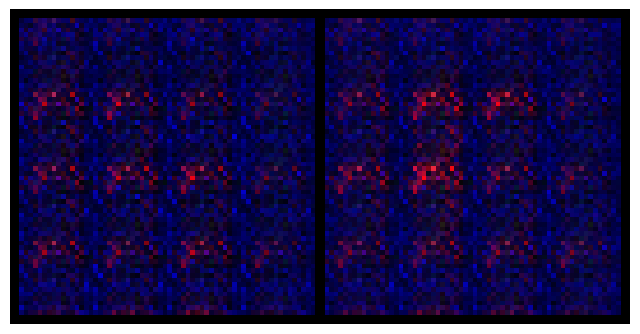

In [18]:
import matplotlib
matplotlib.rcParams['animation.embed_limit'] = 2**128

fig = plt.figure(figsize=(5,5))
plt.axis("off")
ims = [[plt.imshow(np.transpose(i,(1,2,0)), animated=True)] for i in img_list]
ani = animation.ArtistAnimation(fig, ims, interval=1000, repeat_delay=1000, blit=True)

HTML(ani.to_jshtml())

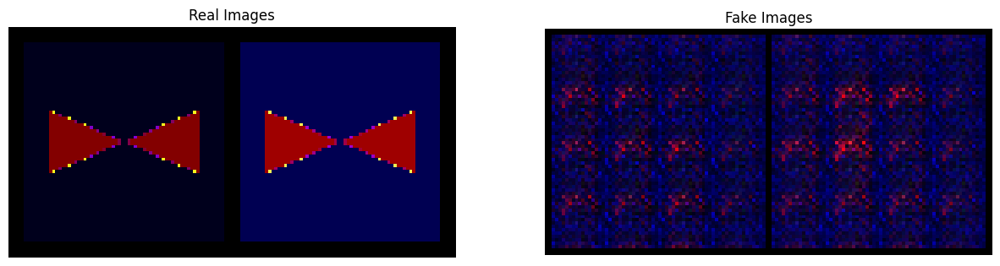

In [19]:
# Grab a batch of real images from the dataloader
real_batch = next(iter(train_dataloader_images))

# Plot the real images
plt.figure(figsize=(15,15))
plt.subplot(1,2,1)
plt.axis("off")
plt.title("Real Images")
plt.imshow(np.transpose(vutils.make_grid(real_batch[0].to(trainer.device)[:64], padding=5, normalize=True).cpu(),(1,2,0)))

# Plot the fake images from the last epoch
plt.subplot(1,2,2)
plt.axis("off")
plt.title("Fake Images")
plt.imshow(np.transpose(img_list[-1],(1,2,0)))
plt.show()